In [2]:
import math

import matplotlib.pyplot as plt
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib as mpl
import math
import sys


In [26]:
# поиск по ключевым точкам, получить peak coord

def matchTemplate(path_img, path_pattern, key):

    # Load the input images
    input_image = cv2.imread(path_img, 0)
    pattern_template = cv2.imread(path_pattern, 0)





    sift = cv2.SIFT_create()
    kp1, des1 = sift.detectAndCompute(input_image, None)
    kp2, des2 = sift.detectAndCompute(pattern_template, None)

    bf = cv2.BFMatcher(cv2.NORM_L1,crossCheck=True)
    #crossCheck=false - совпадения вида один ко многим, crossCheck=true - совпадения вида один к одному
    matches = bf.match(des1,des2)

    matches = sorted(matches, key = lambda x:x.distance)

    list_kp1 = []
    list_kp2 = []

    max_x = -1 #x2
    max_y = -1 #y2
    min_x = sys.maxsize #x1
    min_y =  sys.maxsize #y1


    # For each match...
    for mat in matches:
        # Get the matching keypoints for each of the images
        img1_idx = mat.queryIdx
        img2_idx = mat.trainIdx
        # x - columns
        # y - rows
        # Get the coordinates
        (x1, y1) = kp1[img1_idx].pt
        (x2, y2) = kp2[img2_idx].pt
        # Append to each list
        list_kp1.append((math.ceil(x1), math.ceil(y1)))
        list_kp2.append((math.ceil(x2), math.ceil(y2)))


    for i in range(0,key):
        (x1, y1)= list_kp1[i]
        if x1> max_x:
            max_x = math.ceil(x1)
        elif x1< min_x:
            min_x = math.ceil(x1)
        if y1> max_y:
            max_y = math.ceil(y1)
        elif y1< min_y:
            min_y = math.ceil(y1)


    # print(min_x, min_y)
    # print(max_x, min_y)
    # print(list_kp1)
    # print(list_kp2)
    # print('Количество совпадений ', len(matches))
    # for i in range(0,5): #выведем первые 3
    #     print('Расстояние ',matches[i].distance,'Индекс 1 ',matches[i].trainIdx,'Индекс 2 ', matches[i].queryIdx)
    #
    # matching_result = cv2.drawMatches(input_image, kp1, pattern_template, kp2, matches[:20], None, [255,0,0], flags=2)
    #
    # for i in range(0,15):
    #     cv2.circle(matching_result,list_kp1[i], radius=5, color=(0, 0, 255), thickness=-1)
    #
    # cv2.circle(matching_result,(max_x, max_y), radius=5, color=(0, 255,0), thickness=-1)
    # cv2.circle(matching_result,(min_x, min_y), radius=5, color=(0, 255, 0), thickness=-1)
    # mpl.rcParams['figure.dpi'] = 400
    # plt.axis('off')
    # plt.imshow(cv2.cvtColor(matching_result, cv2.COLOR_BGR2RGB))
    #


    height, width =  input_image.shape
    highlight_start =(min_x, min_y)
    highlight_end = (max_x, max_y)
    return highlight_start, highlight_end


In [18]:
def show(path_img, path_pattern, highlight_start, highlight_end,row):
    input_image = cv2.imread(path_img, 0)
    pattern_template = cv2.imread(path_pattern, 0)
    cv2.rectangle(input_image,(row["x1"],row["y1"]), (row["x2"],row["y2"]),(255,0,0,), 2)
    cv2.rectangle(input_image, highlight_start, highlight_end, (255,0,0), 2)
    # Visualize the pattern template and resulting image
    fig_instance, axes_arr = plt.subplots(1, 2, figsize=(10, 5))

    # Show the pattern template
    axes_arr[0].imshow(cv2.cvtColor(pattern_template, cv2.COLOR_BGR2RGB))
    axes_arr[0].set_title('Pattern')

    # Show the input image with the highlighted match
    axes_arr[1].imshow(cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB))
    axes_arr[1].set_title('Image')


    plt.show()

In [5]:
# iou

def iou(row, highlight_start, highlight_end):
    true_points_set = set([])
    pred_points_set= set([])

    for x in range(row["x1"], row["x2"]):
        for y in range(row["y1"], row["y2"]):
                true_points_set.add((x,y))

        for x in range(highlight_start[0],highlight_end[0]):
            for y in range(highlight_start[1], highlight_end[1]):
                pred_points_set.add((x,y))
    iou_metric = len(true_points_set.intersection(pred_points_set)) / len(true_points_set.union(pred_points_set))
    return iou_metric

Количество совпадений  726
Расстояние  77.0 Индекс 1  561 Индекс 2  7695
Расстояние  84.0 Индекс 1  401 Индекс 2  7407
Расстояние  88.0 Индекс 1  38 Индекс 2  5913
Расстояние  102.0 Индекс 1  460 Индекс 2  7426
Расстояние  108.0 Индекс 1  45 Индекс 2  6841
0.6054709014136221
iou_mean 0.6054709014136221 key 18


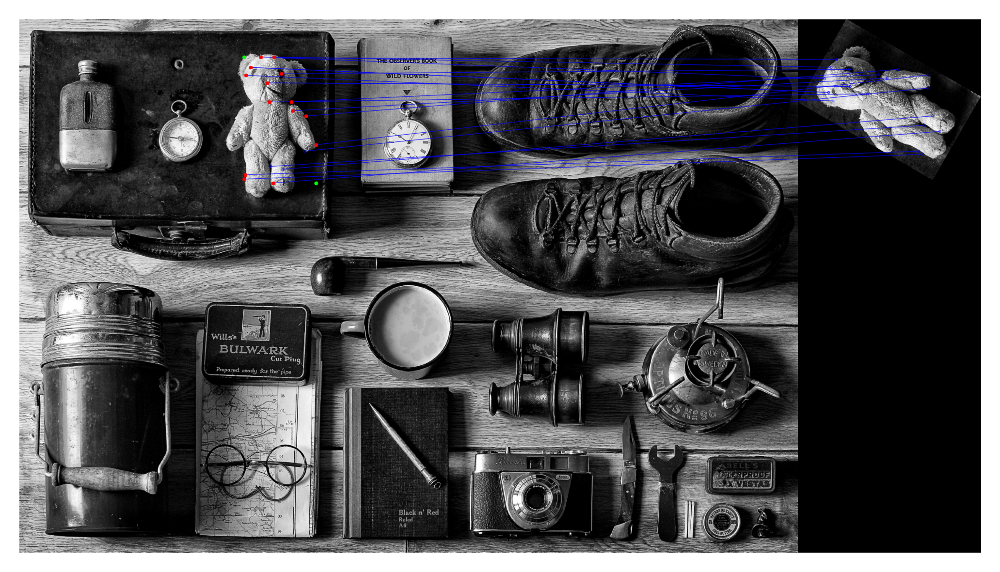

In [25]:
# загрузка изображений, перебор
import statistics
from PIL import Image, ImageFilter
import numpy as np
import pandas as pd
dataset = pd.read_csv('dataset/annotation.csv', delimiter=';')
dataset.head()
iou_array=[]
for key in range(18,19):
    row = dataset.iloc[1]
    highlight_start, highlight_end =matchTemplate(f"dataset/{row['id']}.jpg", f"dataset/pattern/cropped_img_{row['id']}.jpg",key)
    iou_metric = iou(row,highlight_start,highlight_end)
    print(iou_metric)
    iou_array.append(iou_metric)

    iou_mean = statistics.mean(iou_array)
    print("iou_mean",iou_mean,"key", key)

In [82]:
# загрузка изображений, перебор
import statistics
from PIL import Image, ImageFilter
import numpy as np
import pandas as pd
dataset = pd.read_csv('dataset/annotation.csv', delimiter=';')
dataset.head()
iou_array=[]
for key in range(9,20):
    for i in range(0,36):
        row = dataset.iloc[i]
        highlight_start, highlight_end =matchTemplate(f"dataset/{row['id']}.jpg", f"dataset/pattern/cropped_img_{row['id']}.jpg",key)

        iou_metric = iou(row,highlight_start,highlight_end)
        print(iou_metric)
        iou_array.append(iou_metric)

    iou_mean = statistics.mean(iou_array)
    print("iou_mean",iou_mean,"key", key)

0.11155348557692307
0.52120433266018
0.42464761904761905
0.08538461538461538
0.543864951213194
0.46799116997792495
0.3272462100981882
0.33443800055233364
0.09358330473843467
0.39096933271690554
0.3813047461761565
0.16849725411882177
0.4671562221088869
0.1499854124353378
0.13272727272727272
0.20765350604060281
0.6511993603411513
0.15223135036948354
0.4060202205882353
0.42751984857248015
0.19654735508394044
0.10771442659060224
0.3359880537580886
0.507347360431776
0.4187473990844777
0.18279492008305567
0.352821194989469
0.35201149425287354
0.4687704739025988
0.21994134897360704
0.32238183283553784
0.5133467194236107
0.36355377906976744
0.1727730342806168
0.2541997251894863
0.49074074074074076
iou_mean 0.3251349465037499 key 9
0.337890625
0.6054709014136221
0.42464761904761905
0.08538461538461538
0.6249676193765651
0.2719501770667969
0.3272462100981882
0.33443800055233364
0.09358330473843467
0.39096933271690554
0.38387245490461547
0.13264554163596168
0.4671562221088869
0.1499854124353378
0

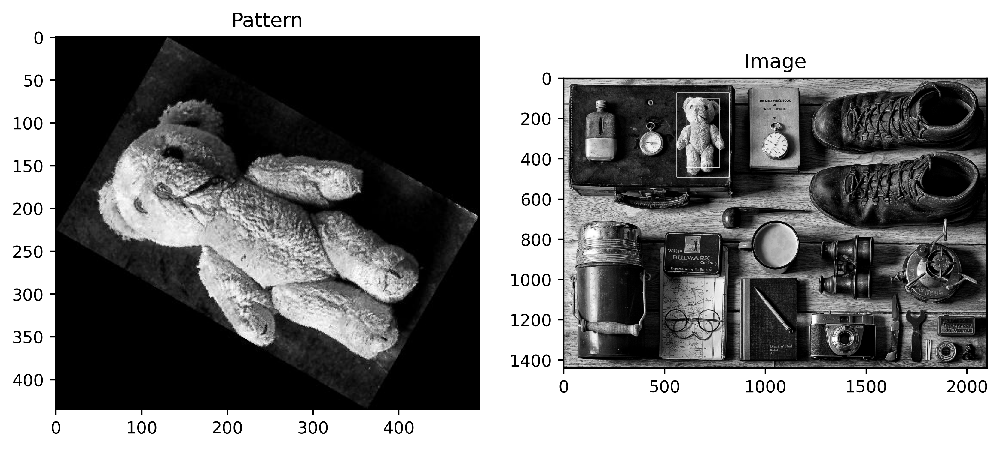

0.52120433266018
iou_mean 0.52120433266018 key 9


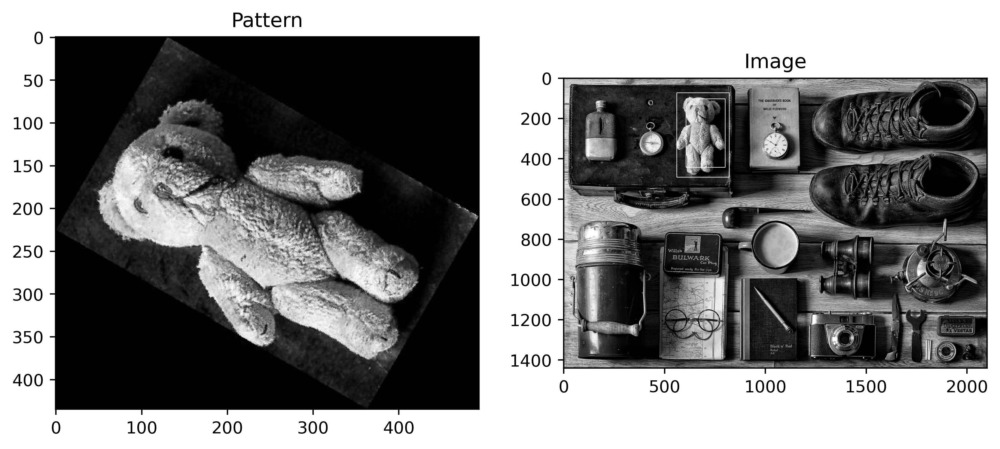

0.6054709014136221
iou_mean 0.5633376170369011 key 10


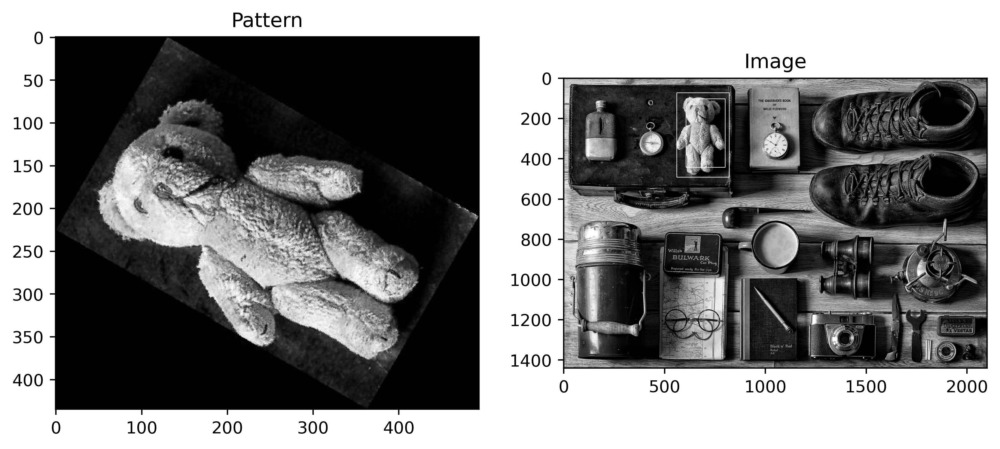

0.6054709014136221
iou_mean 0.5773820451624747 key 11


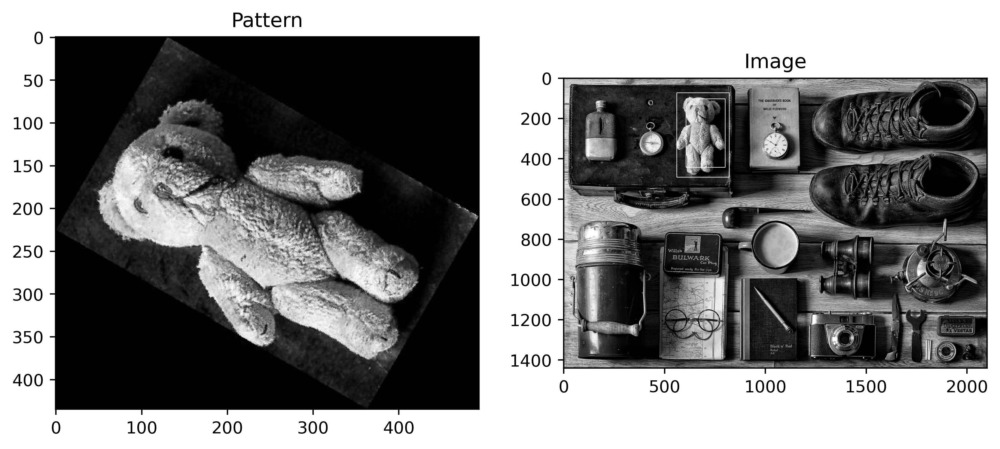

0.6054709014136221
iou_mean 0.5844042592252616 key 12


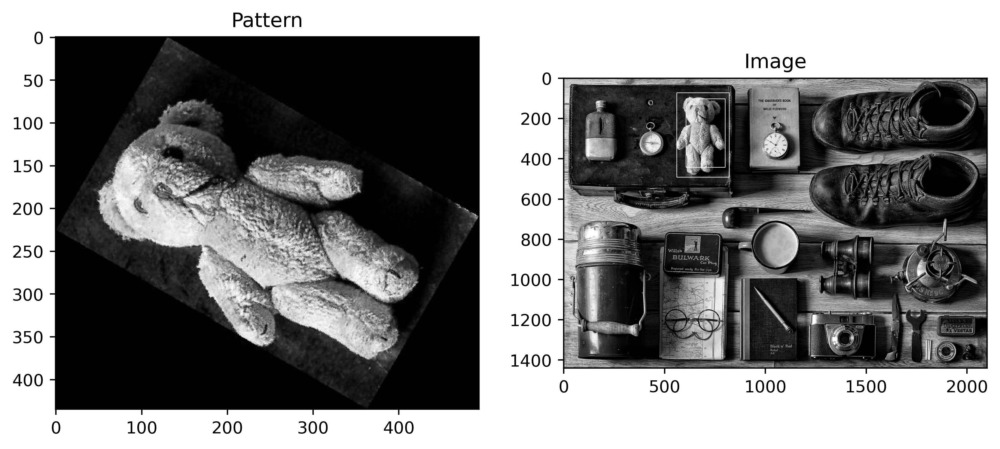

0.6054709014136221
iou_mean 0.5886175876629337 key 13


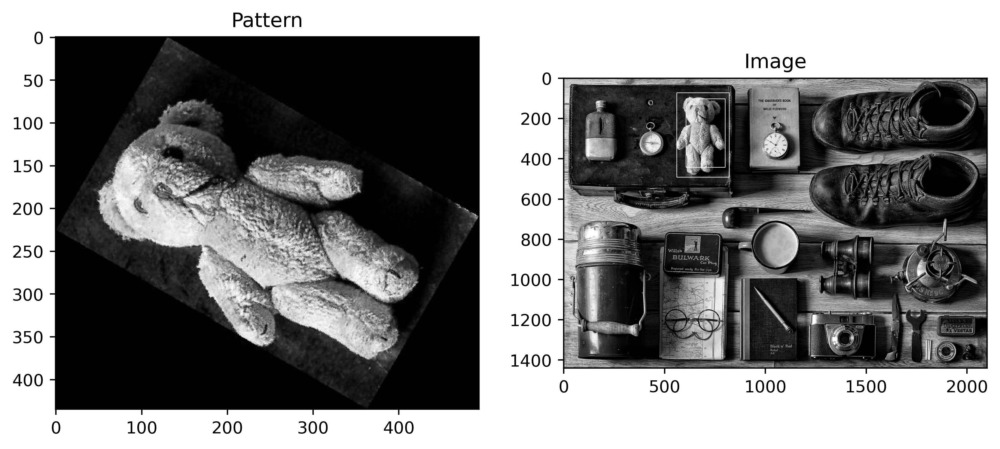

0.6054709014136221
iou_mean 0.5914264732880484 key 14


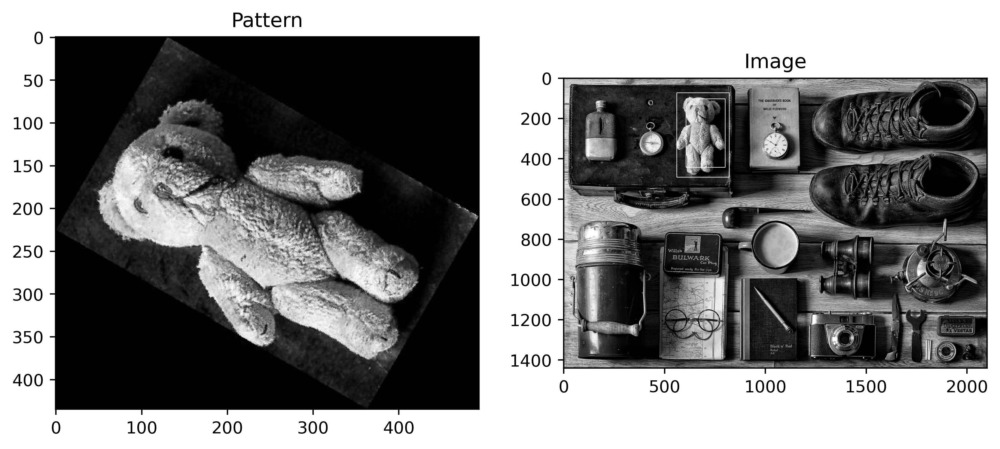

0.6054709014136221
iou_mean 0.5934328201631304 key 15


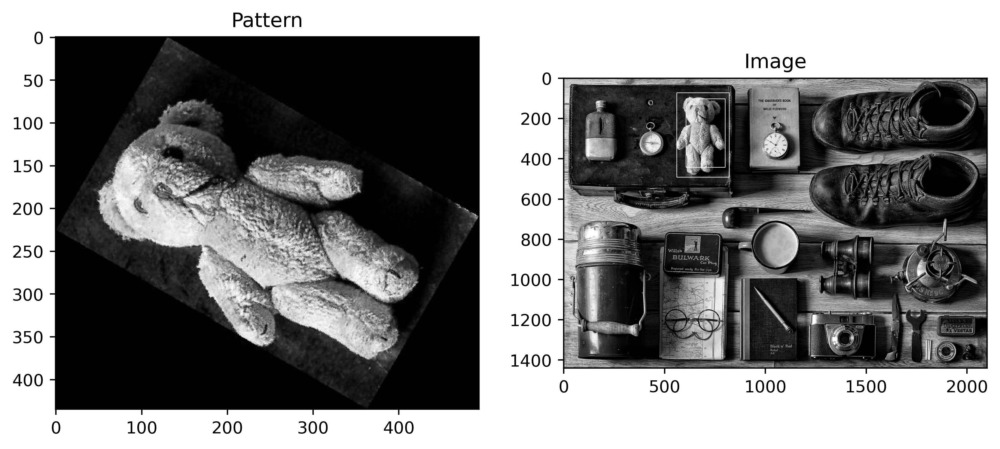

0.6054709014136221
iou_mean 0.5949375803194419 key 16


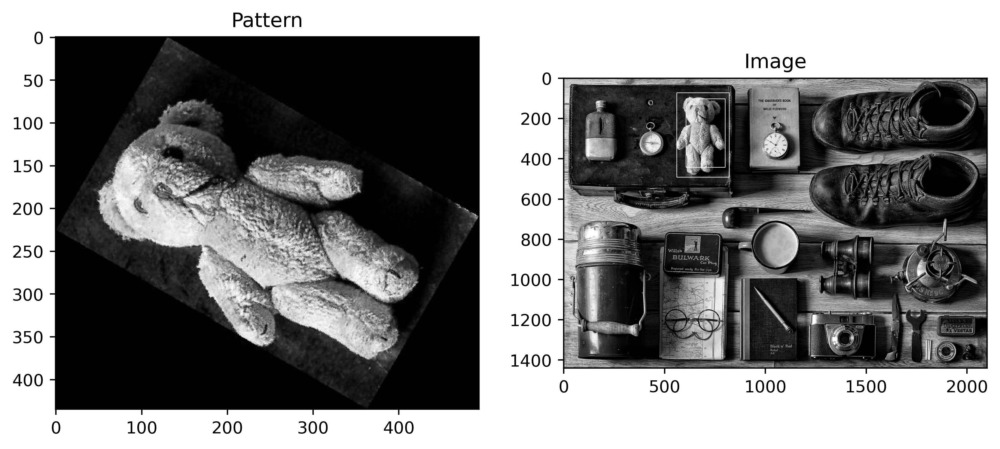

0.6054709014136221
iou_mean 0.5961079493299063 key 17


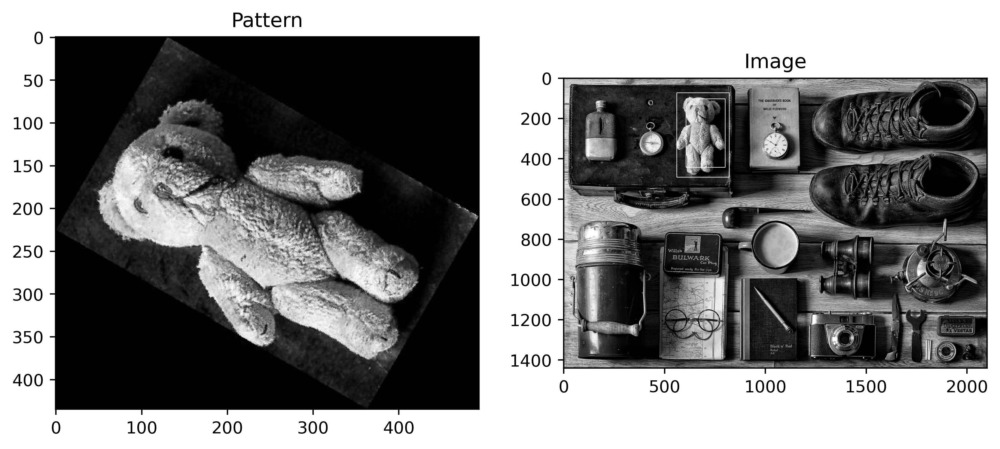

0.6054709014136221
iou_mean 0.597044244538278 key 18


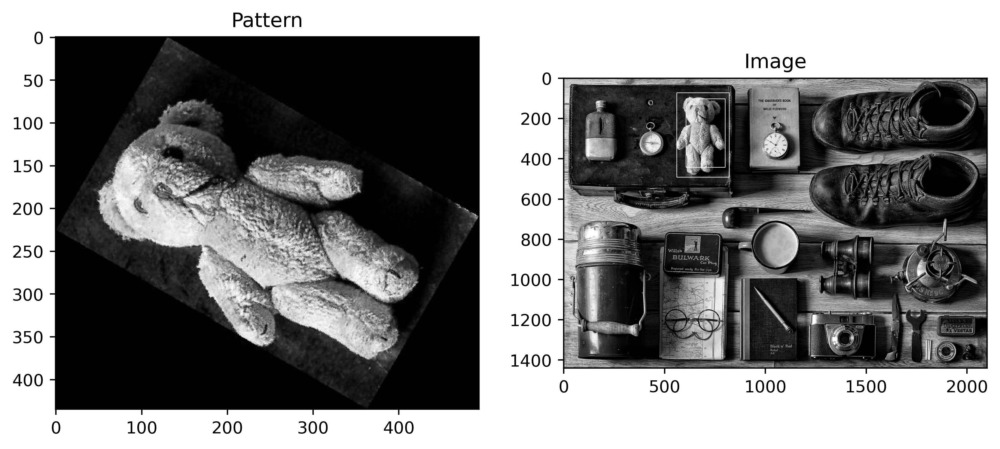

0.6054709014136221
iou_mean 0.5978103042542183 key 19


In [28]:
# загрузка изображений, перебор
import statistics
from PIL import Image, ImageFilter
import numpy as np
import pandas as pd
dataset = pd.read_csv('dataset/annotation.csv', delimiter=';')
dataset.head()
iou_array=[]
for key in range(9,20):
    row = dataset.iloc[1]
    highlight_start, highlight_end =matchTemplate(f"dataset/{row['id']}.jpg", f"dataset/pattern/cropped_img_{row['id']}.jpg",key)
    show(f"dataset/{row['id']}.jpg", f"dataset/pattern/cropped_img_{row['id']}.jpg", highlight_start, highlight_end,row)
    iou_metric = iou(row,highlight_start,highlight_end)
    print(iou_metric)
    iou_array.append(iou_metric)

    iou_mean = statistics.mean(iou_array)
    print("iou_mean",iou_mean,"key", key)

In [32]:
# загрузка изображений, перебор
import statistics
from PIL import Image, ImageFilter
import numpy as np
import pandas as pd
dataset = pd.read_csv('dataset/annotation.csv', delimiter=';')
dataset.head()
iou_array=[]
for key in range(25,26):
    for i in range(0,36):
        row = dataset.iloc[i]
        highlight_start, highlight_end =matchTemplate(f"dataset/{row['id']}.jpg", f"dataset/pattern/cropped_img_{row['id']}.jpg",key)

        iou_metric = iou(row,highlight_start,highlight_end)
        print(iou_metric)
        iou_array.append(iou_metric)

    iou_mean = statistics.mean(iou_array)
    print("iou_mean",iou_mean,"key", key)

0.10288275755467965
0.6054709014136221
0.5904
0.057681348204835954
0.35252861007318365
0.0768584263150268
0.5736000985990716
0.4218236582694414
0.04729973321796813
0.47295423023578365
0.6115581906990587
0.025828744083199816
0.11761813710314625
0.4566272428380668
0.6226704545454546
0.35519678664839954
0.6807569296375267
0.2654901505476218
0.689889705882353
0.5440173861226493
0.04245260493768206
0.07176849861836046
0.14789049240827856
0.5683399392814977
0.2745710237707929
0.4840648993191366
0.4103566153897214
0.5560344827586207
0.5759835272829377
0.3583414793092212
0.26440554339897887
0.2675309873201311
0.04475555446202298
0.5183191028418503
0.5103142591197198
0.012254094153370686
iou_mean 0.3549593498989837 key 25
